# Analyzing Boating Patterns in the path of Hurricane Fiona
Bharat Khanna (2025)

The purpose of this notebook is to visualize the impact of Hurricane Fiona on the island of Puerto Rico. I took this project on as I've been interested in exploring the Marine AIS data which provides point in time position and destinations of boating traffic in the United States.

Hurricane Fiona was a fierce and destructive storm that hit in mid-September 2022. It cranked up to a Category 4 hurricane with winds hitting 140 mph (220 km/h). Fiona tore through the Caribbean, causing a lot of damage in places like Puerto Rico, the Dominican Republic, and the Turks and Caicos. Then, it turned into a powerful storm and hit Atlantic Canada hard, becoming the most intense post-tropical cyclone to hit Canada. The damage left behind was pretty extensive and left many people dealing with the aftermath.

We'll be analyzing this by examining public data available from the United States Coast Guard (USCG) via the Marine Cadaste as well as International Best Track hurricane paths as prepared in concert with the National Oceanographic and Atmospheric Administration (NOAA).

We'll start by import our libraries and pulling and limiting our ship position data to those near the island of Puerto Rico during September of 2022.

In [1]:
import pandas as pd 
import geopandas as gpd 
import numpy as np
import gc
from shapely.geometry import box
import h3
import geodatasets
import geoplot
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import duckdb
import seaborn as sns
import xgboost as xgb
import shap
from shapely.geometry import Polygon
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

gc.collect()


0

In [2]:
#Future conversion function
def cell_to_shapely(coords):
    flipped = tuple(coord[::-1] for coord in coords)
    return Polygon(flipped)

#Create a bounding box of vessels around Puerto Rico
tl = (-71.18486, 22.33182)
br = (-61.14655, 14.55181)
bbox = box(br[0], tl[1], tl[0], br[1]) 

#Pull in hurricane tracks
all_tracks = gpd.read_file('./IBTrACS.last3years.list.v04r01.lines.shp')

best_track = all_tracks\
    .query("NAME == 'FIONA'")

btd = best_track['day'].unique()

#Pull in countries
countries = gpd.read_file('./world-administrative-boundaries.geojson')
countries = countries[countries['geometry'].intersects(bbox)]

#Pull in Marine Highways
mh = gpd.read_file('marine_highways.geojson')
mh = mh[mh.intersects(bbox)]

In [3]:
#Pull in AIS tracks package from 2022 and box to Puerto Rico ships, pulling track data will help us limit to only interested MMSI data
ais2022 = gpd.read_file('./AISVesselTracks2022.gpkg')

ais_pr_22 = ais2022[ais2022['geometry'].intersects(bbox)]
ais_pr_22 = ais_pr_22[(ais_pr_22['TrackEndTime'].dt.month==9) | (ais_pr_22['TrackStartTime'].dt.month == 9)]

/opt/anaconda3/envs/ais/lib/python3.12/site-packages/pyogrio/raw.py:196: RuntimeWarning: Non-conformant content for record 1 in column TrackStartTime, 2022-01-01T00:02:22.0Z, successfully parsed
  return ogr_read(


In [4]:
#Get PR MMSIs
pr_mmsi = ais_pr_22[['MMSI']].drop_duplicates()
del ais2022, ais_pr_22
gc.collect()

51

In [5]:
# Set up DuckDB to read in CSV files, join to PR file and return to pandas / close connection
con = duckdb.connect()
csv_pattern = 'AIS_2022_09_*.csv'
con.execute(f"CREATE TABLE ais_sept AS SELECT * FROM read_csv_auto('{csv_pattern}')")
con.execute(f"CREATE TABLE ais_pr AS SELECT * FROM ais_sept A INNER JOIN pr_mmsi B ON A.MMSI = B.MMSI")
ais_pr = con.execute("SELECT * FROM ais_pr").df() #pd.read_sql("SELECT * FROM ais_pr",con)
con.close()
gc.collect()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

0

In [6]:
#Create dataframe and assign H3
ais_pd = gpd.GeoDataFrame(
    ais_pr, geometry=gpd.points_from_xy(ais_pr.LON, ais_pr.LAT), crs="EPSG:4326"
)

#Set H3 at resolution 5, map in polygon
ais_pd['H3'] = ais_pd.apply(lambda row: h3.latlng_to_cell(row['LAT'], row['LON'], 5  ),axis=1)
ais_pd['H3_GEO'] = ais_pd['H3'].apply(lambda x: h3.cell_to_boundary(x))
ais_pd['H3_GEO_S'] = ais_pd['H3_GEO'].apply(cell_to_shapely)

Through the following set of daily progressions we can see how the storm's approach dramatically shifts vessel traffic in the day or two leading up to the storms path as well as the precipitous drop in maritime traffic. We accomplish this by reducing the actual positioned latitude / longitude to an H3 positional grid. Positions are resolved to H3's level 5 resolution.

In [7]:
###
### Plotting Helper Functions
###


def clean_axis(ax):
    
    # Remove the frame (box) from the subplot
    ax.set_frame_on(False)

    # Set the limits for the x and y axes based on top-left (tl) and bottom-right (br) coordinates
    ax.set_xlim([tl[0], br[0]])
    ax.set_ylim([br[1], tl[1]])

    # Hide the x and y axis tick marks and labels
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # Remove the margins from the subplot
    ax.set_xmargin(0)
    ax.set_ymargin(0)

    # Set the background color of the figure
    ax.set_facecolor('#E5F3FD')

    return ax

def add_countries(ax):
    countries.plot(ax=ax, color='#efe5e5', edgecolor='#b9b0b0',zorder=0)
    return ax

def setup_figure(s=None,fs=(6,4)):
    fig = plt.figure(figsize=fs,dpi=150)
    if s == None:
        ax = fig.subplots()
    else:
        ax = fig.subplots(*s)
    fig.set_facecolor('#E5F3FD')
    return fig,ax



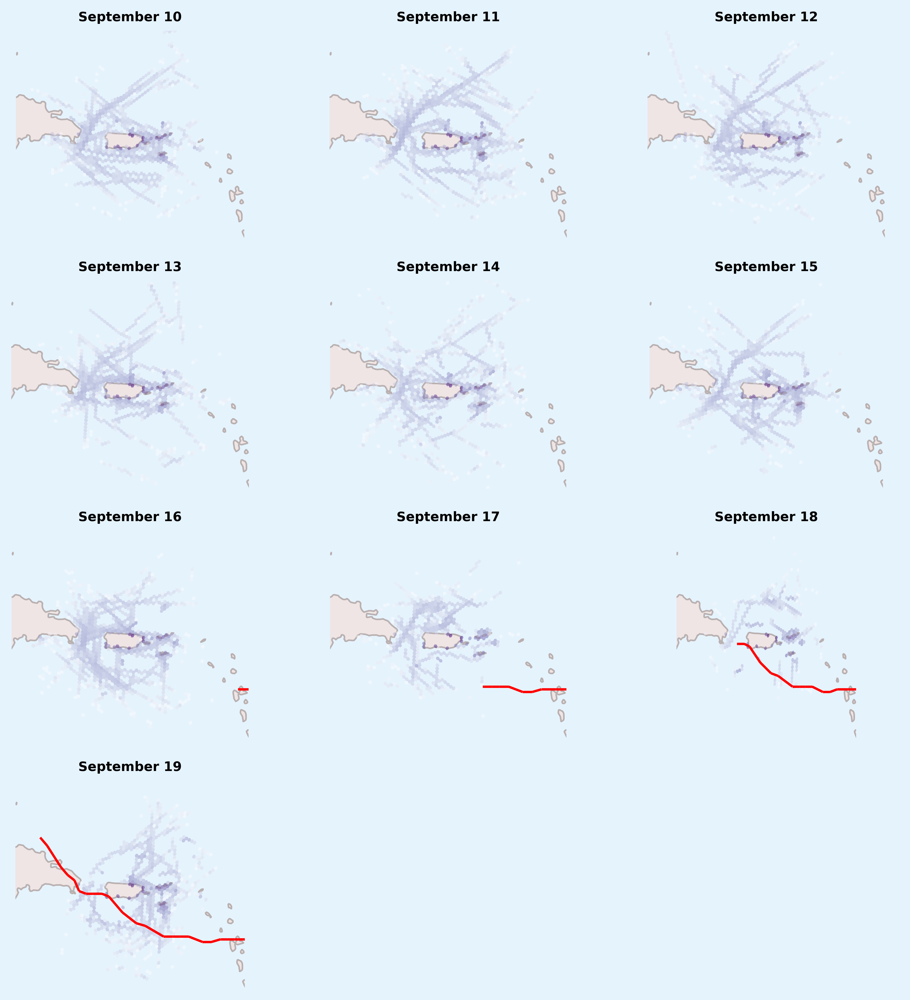

In [8]:

# Create a figure object with specific size and resolution
fig = plt.figure(figsize=(10,10), dpi=600)

# Create a 4x3 grid of subplots within the figure
ax = fig.subplots(4, 3)

# Set the background color of the figure
fig.set_facecolor('#E5F3FD')

# Initialize a counter
cnt = 10

# Loop through each subplot position
for i in range(4):
    for j in range(3):


        # Check if the counter is less than 20
        if cnt < 20:
            # Set the title of the subplot with a specific font weight and size
            ax[i][j].set_title(f"September {cnt}", fontweight='bold', fontsize='small')

            # Filter the best_track DataFrame for entries with day less than or equal to the counter
            btpr_i = best_track.query("day <= @cnt")
            if len(btpr_i) > 0:
                # Plot the filtered data on the subplot
                btpr_i.plot(ax=ax[i][j], color='red')

            ax[i][j] = add_countries(ax[i][j])

            # Prepare the H3 polygons and filter the AIS data for the specific day
            h3_polys = ais_pd.drop_duplicates(subset='H3')[['H3', 'H3_GEO_S']]
            h3_sum = ais_pd[ais_pd['BaseDateTime'].dt.day == cnt].assign(CNT=1)\
                        .pivot_table(index='H3', values='CNT', aggfunc="sum").reset_index()
            h3_test = gpd.GeoDataFrame(h3_sum\
                        .merge(h3_polys, how='left', on='H3'))\
                        .set_geometry('H3_GEO_S')\
                        .set_crs('EPSG:4326')

            # Add a new column with the logarithm of the count and plot the data on the subplot
            h3_test.assign(LOG_CNT=lambda df: np.log(df['CNT']))\
                    .plot(column='LOG_CNT', cmap='Purples', ax=ax[i][j], alpha=0.5)


        #Clean and prepare the axis
        ax[i][j] = clean_axis(ax[i][j])
        
        # Increment the counter
        cnt = cnt + 1

# Adjust the layout and spacing of the figure
fig.tight_layout()
fig.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.05, hspace=0.2, wspace=0.2)

## Simulating Ship Traffic
Working the the hypothesis and visual evidence that ships naturally reduced movement on days of the hurricane as well as repositioned away from the storm we'll attempt to model this effect.

We'll look at and construct the following features for each H3 cell:

* On a US DOT Marine Highay
* On or an international shipping lane
* On or how far away from land
* In or how far away from the storm
* How far away from a dock

### Defining the Grid Space

First we'll construct a bounding grid of all the cells in our area of interest to serve as a base set to capture whether there was any ship traffic in that cell

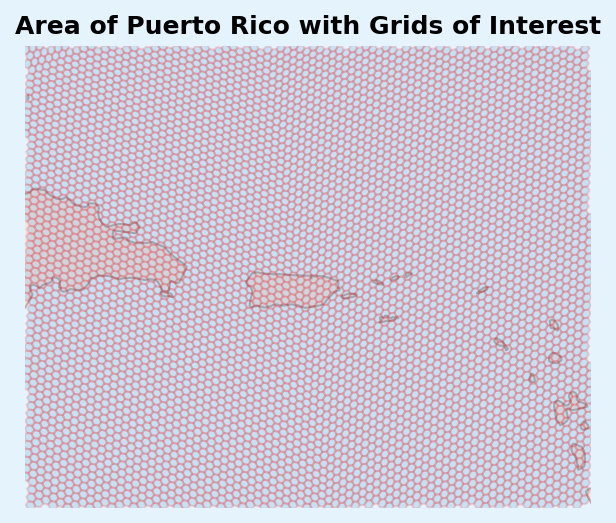

In [9]:
map_area_cells = gpd.GeoDataFrame(pd.DataFrame(h3.geo_to_cells(Polygon(bbox),5),columns=['H3'])\
    .assign(H3_BOUNDARY = lambda df: df['H3'].apply(h3.cell_to_boundary))\
    .assign(H3_GEOM = lambda df: df['H3_BOUNDARY'].apply(cell_to_shapely)))\
    .set_geometry('H3_GEOM')\
    .set_crs('EPSG:4326')

fig,ax = setup_figure()

ax = add_countries(ax)
map_area_cells.plot(ax=ax,alpha=.15,edgecolor='red')
ax.set_title('Area of Puerto Rico with Grids of Interest',fontweight='bold')
ax = clean_axis(ax)

### Capturing our Training Data

For a given day through our period of interest September 10th - 30th, capture the count of ships within a given H3 cell for the day. We'll apply for this and certain other counts a log + 1 transformation to aid in modeling.

In [10]:
#Capture daily cell ship counts
ship_daily_cell_counts = ais_pd\
    .assign(Day=lambda df: df['BaseDateTime'].dt.day)\
    .pivot_table(index=['H3','Day'],values='MMSI',
        aggfunc=len
    )\
    .rename(columns={'MMSI':'SHIP_COUNT'})\
    .assign(LOG_SHIP_COUNT = lambda df: np.log1p(df['SHIP_COUNT']))\
    .reset_index()

display(ship_daily_cell_counts)

,H3,Day,SHIP_COUNT,LOG_SHIP_COUNT
0,85035e7bfffffff,18,1,0.693147
1,85280003fffffff,24,9,2.302585
2,85280013fffffff,24,35,3.583519
3,8528002bfffffff,24,35,3.583519
4,8528003bfffffff,24,34,3.555348
...,...,...,...,...
32636,85677537fffffff,21,1,0.693147
32637,85677553fffffff,21,1,0.693147
32638,85677557fffffff,21,1,0.693147
32639,856775affffffff,21,2,1.098612


Take the best track storm estimate and map it to H3 cells, perserving the storm wind factor for each cell

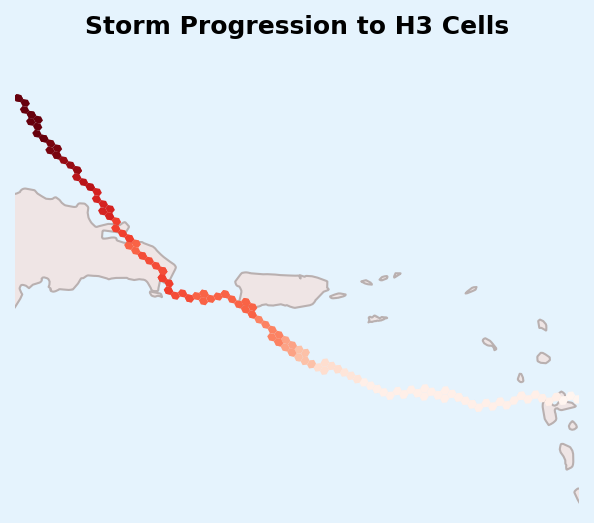

In [11]:
#Map storm cells
storm_cells = map_area_cells\
    .sjoin(
        best_track[['day','USA_WIND','geometry']],
        predicate='intersects'
    )\
    .drop(['index_right'],axis=1)\
    .rename(columns={'day':'Day'})

fig,ax = setup_figure()
ax = add_countries(ax)
storm_cells.plot(ax=ax,column='USA_WIND',cmap='Reds')
ax.set_title('Storm Progression to H3 Cells',fontweight='bold')
ax = clean_axis(ax)

We'll list the major land bodies and which cells cover or contain part of land

Text(0.5, 1.0, 'Land Overlaid with Cells')

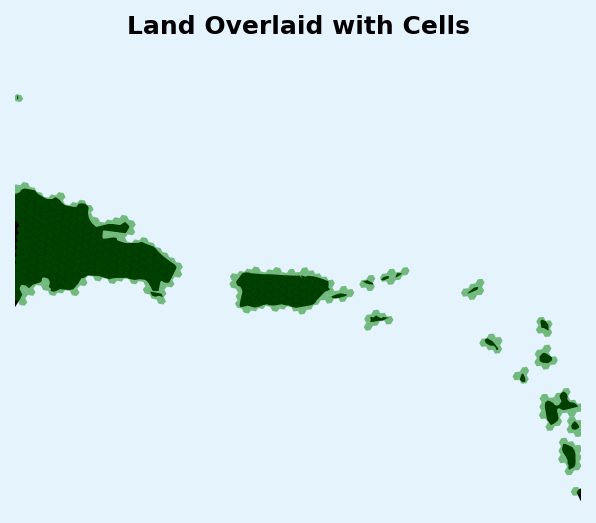

In [12]:
#Map land cells
land_cells = map_area_cells\
    .sjoin(
        countries[['name','geometry']],
        predicate='intersects'
    )\
    .drop(['index_right'],axis=1)

fig,ax = setup_figure()
countries.plot(ax=ax,color='black')
land_cells.plot(ax=ax,color='Green',alpha=.50)
ax=clean_axis(ax)
ax.set_title('Land Overlaid with Cells',fontweight='bold')

Set up cells for the the marine highay around the island

,H3,H3_BOUNDARY,H3_GEOM,index_right,OBJECTID,linknum,mh_id,ww_name,st_usps,st_fips,...,MANUUP,MANUDOWN,FARMUP,FARMDOWN,MACHUP,MACHDOWN,WASTEUP,WASTEDOWN,UNKWNUP,UNKWDOWN
142,854ce8cbfffffff,"((18.4247637122795, -65.31589897608482), (18.4...","POLYGON ((-65.3159 18.42476, -65.27245 18.4950...",1170,1171,999999,M-2,Caribbean Sea,XX,XX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
154,854cc5d7fffffff,"((18.65687415778978, -66.81842538381237), (18....","POLYGON ((-66.81843 18.65687, -66.86408 18.603...",60,61,296500,M-2,Puerto Rico Deep Water Loop,PR,72,...,130854.0,222.0,167423.0,35.0,3152.0,53.0,0.0,0.0,0.0,222204.0
154,854cc5d7fffffff,"((18.65687415778978, -66.81842538381237), (18....","POLYGON ((-66.81843 18.65687, -66.86408 18.603...",55,56,296300,M-2,Puerto Rico Deep Water Loop,PR,72,...,130854.0,222.0,167423.0,35.0,3152.0,53.0,0.0,0.0,0.0,222204.0
223,854ceb87fffffff,"((17.62558390963806, -64.76395943077749), (17....","POLYGON ((-64.76396 17.62558, -64.72015 17.696...",1181,1182,999999,M-V1,Caribbean Sea,XX,XX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
369,854cee0ffffffff,"((18.502720695091, -65.78404355717636), (18.57...","POLYGON ((-65.78404 18.50272, -65.74086 18.572...",1170,1171,999999,M-2,Caribbean Sea,XX,XX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4646,854cc1d3fffffff,"((17.879967192552087, -67.00075363455592), (17...","POLYGON ((-67.00075 17.87997, -67.04667 17.825...",33,34,297400,M-2,Puerto Rico Deep Water Loop,PR,72,...,130854.0,222.0,167423.0,35.0,3152.0,53.0,0.0,0.0,0.0,222204.0
4764,854ce32ffffffff,"((18.767984839762754, -66.43557355248264), (18...","POLYGON ((-66.43557 18.76798, -66.48093 18.715...",111,112,296100,M-2,Puerto Rico Deep Water Loop,,,...,130854.0,222.0,167423.0,35.0,3152.0,53.0,0.0,0.0,0.0,222204.0
4765,854ce94ffffffff,"((17.650193089897517, -64.52258012140136), (17...","POLYGON ((-64.52258 17.65019, -64.47864 17.721...",1181,1182,999999,M-V1,Caribbean Sea,XX,XX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4806,854ce80bfffffff,"((18.18672594842646, -65.0914705338044), (18.2...","POLYGON ((-65.09147 18.18673, -65.04788 18.257...",1170,1171,999999,M-2,Caribbean Sea,XX,XX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Text(0.5, 1.0, 'Marine Highway')

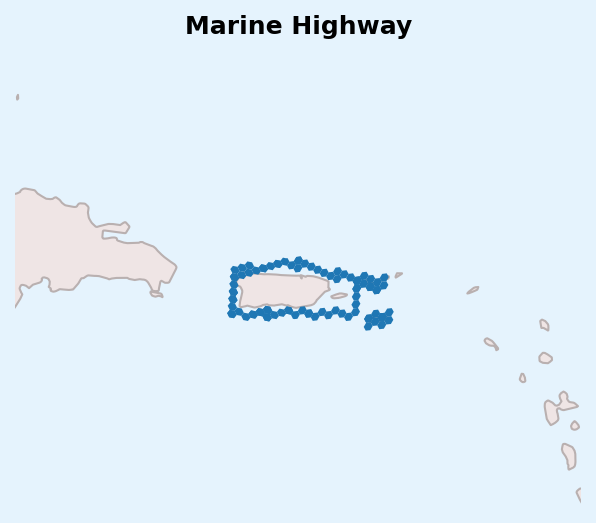

In [13]:
mhc = map_area_cells.sjoin(mh,predicate='intersects')
display(mhc)
fig,ax = setup_figure()
mhc.plot(ax=ax)
ax = add_countries(ax)
ax = clean_axis(ax)
ax.set_title('Marine Highway',fontweight='bold')

Set up a daily bounding map and map the nearest storm information for a given day when avaialble

In [14]:
#Construct a dataframe for map area per day
daily_map = map_area_cells\
    .assign(A=1)\
    .merge(ship_daily_cell_counts[['Day']].drop_duplicates().assign(A=1),how='inner',on='A')

In [15]:
#Set up helper functions to calculate distance, some cells on far end of the map don't work well with the built-in grid_distance so we'll calculate manually
def find_my_dist(a,b):
    try:
        d = h3.grid_distance(a,b)
        return d
    except:
        return None
    
def find_my_dist_slow(a,b):
    rcnt = 1
    while True:
        if rcnt >= 100:
            raise Exception
        rings = h3.grid_disk(a,rcnt)
        if b in rings:
            return rcnt 
        else:
            rcnt += 1

In [16]:
nearest_storm_cell = pd.concat([d.to_crs(epsg=3395).sjoin_nearest(storm_cells.query("Day == @i").to_crs(epsg=3395)) for i,d in daily_map.groupby('Day')])[
        ['H3_left','H3_GEOM','Day_left','USA_WIND','H3_right']
    ]\
    .rename(columns={
        'H3_left':'H3',
        'Day_left':'Day',
    })

nearest_storm_cell['DIST'] = nearest_storm_cell.apply(lambda row: find_my_dist(row['H3'],row['H3_right']),axis=1)

#Calculate missing NSD
nsd = nearest_storm_cell[pd.isnull(nearest_storm_cell['DIST'])][['H3','H3_right']].drop_duplicates()\
    .assign(DIST = lambda df: df.apply(lambda row: find_my_dist_slow(row['H3'],row['H3_right']),axis=1))


#Calculate NSD
nearest_storm_cell = pd.concat([
    nearest_storm_cell[~pd.isnull(nearest_storm_cell['DIST'])],
    nearest_storm_cell[pd.isnull(nearest_storm_cell['DIST'])]\
    .drop(['DIST'],axis=1)\
    .merge(nsd,how='left',on=['H3','H3_right'])
])\
.sort_values(['H3','Day','DIST'])\
.drop_duplicates(subset=['H3','Day'],keep='first')

Pull in port data

/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/773709341.py:16: FutureWarning: The provided callable <function sum at 0x1169e9620> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  .pivot_table(index='Neighbors',values='NUM_DOCKS',aggfunc=np.sum)\


,H3,H3_BOUNDARY,H3_GEOM,NUM_DOCKS,NEIGHBOR_DOCKS,Is_Dock,Is_Neighbor_Dock
0,854ceddbfffffff,"((19.10922120678209, -64.44289165863691), (19....","POLYGON ((-64.44289 19.10922, -64.39902 19.179...",0.0,0.0,False,False
1,854ceacbfffffff,"((17.870563633630706, -66.17185033432631), (17...","POLYGON ((-66.17185 17.87056, -66.12884 17.940...",9.0,109.0,True,True
2,854ca937fffffff,"((21.25416283874579, -69.64463222910209), (21....","POLYGON ((-69.64463 21.25416, -69.69176 21.202...",0.0,0.0,False,False
3,854d41cffffffff,"((20.72798612058981, -61.41736531158456), (20....","POLYGON ((-61.41737 20.72799, -61.37213 20.797...",0.0,0.0,False,False
4,854c19cffffffff,"((21.5807320365374, -67.59518932067054), (21.5...","POLYGON ((-67.59519 21.58073, -67.64088 21.530...",0.0,0.0,False,False
...,...,...,...,...,...,...,...
4890,854ceba3fffffff,"((17.43676713183064, -64.65428804771142), (17....","POLYGON ((-64.65429 17.43677, -64.6104 17.5079...",0.0,12.0,False,True
4891,854cf4d3fffffff,"((21.326183525747396, -69.38326850163934), (21...","POLYGON ((-69.38327 21.32618, -69.43021 21.275...",0.0,0.0,False,False
4892,854ceeb3fffffff,"((18.870836572729733, -65.40938166483888), (18...","POLYGON ((-65.40938 18.87084, -65.36602 18.940...",0.0,7.0,False,True
4893,855e6a2ffffffff,"((15.002687319618788, -63.69187359891071), (15...","POLYGON ((-63.69187 15.00269, -63.64731 15.075...",0.0,0.0,False,False


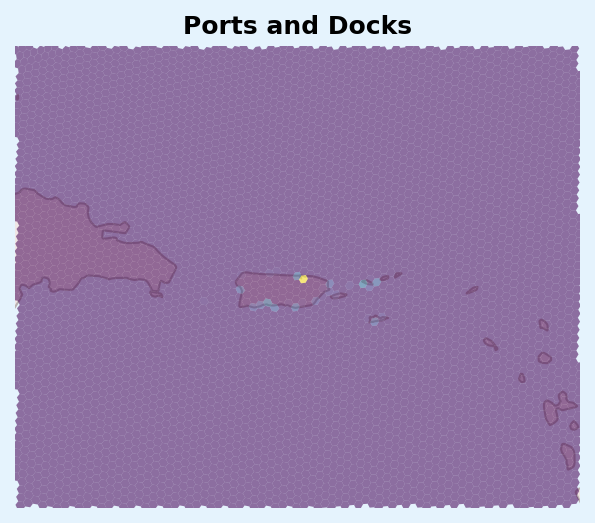

In [17]:
ports = gpd.read_file('Docks.geojson')
ports = ports[ports.intersects(bbox)].set_crs('EPSG:4326')


ports = map_area_cells\
    .sjoin(ports,predicate='intersects').pivot_table(index='H3',values='FID',aggfunc=len)\
    .reset_index()\
    .rename(columns={'FID':'NUM_DOCKS'})\
    .assign(Neighbors = lambda df: df['H3'].apply(lambda x: h3.grid_disk(x,5))) 

ports_sum = map_area_cells\
    .merge(ports[['H3','NUM_DOCKS']].drop_duplicates(),how='left',on='H3')\
    .merge(
            ports\
        .explode('Neighbors')\
        .pivot_table(index='Neighbors',values='NUM_DOCKS',aggfunc=np.sum)\
        .reset_index()\
        .rename(columns={'Neighbors':'H3','NUM_DOCKS':'NEIGHBOR_DOCKS'}),how='left',on='H3'
    )\
    .fillna(0)\
    .assign(Is_Dock = lambda df: df['NUM_DOCKS'] > 0)\
    .assign(Is_Neighbor_Dock = lambda df: df['NEIGHBOR_DOCKS'] > 0)

display(ports_sum)

fig,ax = setup_figure()
ax.set_title('Ports and Docks',fontweight='bold')
ax = add_countries(ax)
ports_sum.plot(column='NUM_DOCKS',ax=ax,alpha=.55)
ax = clean_axis(ax)

Calculate the nearest land for all given cells

In [18]:
nearest_land_cell = pd.concat([d.to_crs(epsg=3395).sjoin_nearest(land_cells.to_crs(epsg=3395)) for i,d in daily_map.groupby('Day')])[
        ['H3_left','Day','H3_GEOM','H3_right']
    ]\
    .rename(columns={
        'H3_left':'H3',
    })\
    .assign(DIST=lambda df: df.apply(lambda row: find_my_dist(row['H3'],row['H3_right']),axis=1))\
    .sort_values(['H3','Day','DIST'])\
    .drop_duplicates(subset=['H3','Day'],keep='first')\
    .drop(['H3_right'],axis=1)

assert len(nearest_land_cell) == len(daily_map)

In [19]:
is_land_neighbors = map_area_cells\
    .merge(land_cells[['H3']].assign(Land=True),how='left',on='H3')\
    .assign(Land=lambda df: df['Land'].fillna(False))\
    .assign(Neighbors = lambda df: df['H3'].apply(lambda x: h3.grid_disk(x,1)))\
    .explode('Neighbors')\
    .merge(land_cells[['H3']].assign(Neighbor_Land=1).rename(columns={'H3':'Neighbors'}),how='left',on='Neighbors')\
    .fillna(0)\
    .pivot_table(index=['H3','Land'],values='Neighbor_Land',aggfunc=np.sum)\
    .reset_index()\
    .assign(Any_Neighbor_Land = lambda df: df['Neighbor_Land'] > 0)

is_land_neighbors.sort_values('Neighbor_Land',ascending=False)



/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/70772583.py:3: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  .assign(Land=lambda df: df['Land'].fillna(False))\
/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/70772583.py:8: FutureWarning: The provided callable <function sum at 0x1169e9620> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  .pivot_table(index=['H3','Land'],values='Neighbor_Land',aggfunc=np.sum)\


,H3,Land,Neighbor_Land,Any_Neighbor_Land
451,854c899bfffffff,True,7.0,True
2467,854ceac3fffffff,True,7.0,True
1563,854cd4dbfffffff,True,7.0,True
2459,854cea9bfffffff,True,7.0,True
2457,854cea93fffffff,True,7.0,True
...,...,...,...,...
1803,854cdb47fffffff,False,0.0,False
1804,854cdb4bfffffff,False,0.0,False
1805,854cdb4ffffffff,False,0.0,False
1806,854cdb53fffffff,False,0.0,False


Pull in [international shipping lanes](https://github.com/newzealandpaul/Shipping-Lanes/tree/main) to understand more useful features

,H3,H3_BOUNDARY,H3_GEOM,SL_TYPE_Middle,SL
0,854c19cffffffff,"((21.5807320365374, -67.59518932067054), (21.5...","POLYGON ((-67.59519 21.58073, -67.64088 21.530...",True,True
1,854c19cffffffff,"((21.5807320365374, -67.59518932067054), (21.5...","POLYGON ((-67.59519 21.58073, -67.64088 21.530...",True,True
2,854d5a4ffffffff,"((21.13626580479196, -65.16229161068313), (21....","POLYGON ((-65.16229 21.13627, -65.11896 21.204...",True,True
3,854d5a4ffffffff,"((21.13626580479196, -65.16229161068313), (21....","POLYGON ((-65.16229 21.13627, -65.11896 21.204...",True,True
4,854d5a4ffffffff,"((21.13626580479196, -65.16229161068313), (21....","POLYGON ((-65.16229 21.13627, -65.11896 21.204...",True,True
...,...,...,...,...,...
1924,854ce583fffffff,"((20.774648783655575, -65.53674783920643), (20...","POLYGON ((-65.53675 20.77465, -65.4936 20.8430...",True,True
1925,854ce583fffffff,"((20.774648783655575, -65.53674783920643), (20...","POLYGON ((-65.53675 20.77465, -65.4936 20.8430...",True,True
1926,854ce583fffffff,"((20.774648783655575, -65.53674783920643), (20...","POLYGON ((-65.53675 20.77465, -65.4936 20.8430...",True,True
1927,854d42a7fffffff,"((21.37656329552415, -62.004250687594585), (21...","POLYGON ((-62.00425 21.37656, -61.95934 21.445...",False,True


Text(0.5, 1.0, 'International Shipping Lanes')

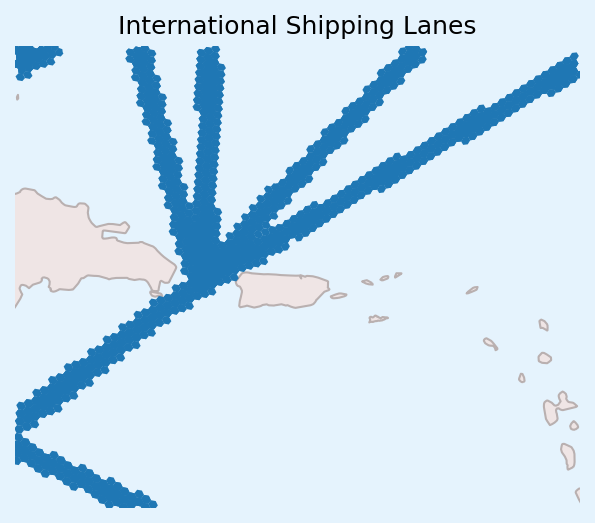

In [20]:
#Read in shipping lanes and pad 1 ring to catch stray traffic, classify lane type

sl = gpd.read_file('Shipping_Lanes_v1.geojson')
sl = sl[sl.intersects(bbox)]

sls = map_area_cells.sjoin(sl,predicate='intersects').drop(['index_right','FID','OBJECTID'],axis=1)
sls = map_area_cells\
    .merge(
        sls\
    .assign(Neighbor=lambda df: df['H3'].apply(lambda x: h3.grid_disk(x,1)))\
    .explode('Neighbor')[['Neighbor','Type']]\
    .rename(columns={'Neighbor':'H3'}),how='inner',on='H3')

sls2 = pd.concat([sls,pd.get_dummies(sls['Type'],drop_first='True',prefix='SL_TYPE')],axis=1).drop(['Type'],axis=1)\
    .assign(SL=True)

display(sls2)

fig, ax = setup_figure()
ax = add_countries(ax)
sls.plot(ax=ax)
ax = clean_axis(ax)
ax.set_title('International Shipping Lanes')

Join the daily map and create some features

/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/2260037131.py:23: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  .assign(SL=lambda df: df['SL'].fillna(False))\
/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/2260037131.py:24: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  .assign(SL_TYPE_Middle = lambda df: df['SL_TYPE_Middle'].fillna(False))\
/var/folders/4y/b7xlt7nn6w1b23t077hy3b_40000gn/T/ipykernel_69411/2260037131.py:25: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will ch

,H3,H3_BOUNDARY,H3_GEOM,Day,USA_WIND,DIST,Marine_Highway,Land,Neighbor_Land,Any_Neighbor_Land,...,SHIP_COUNT,LOG_SHIP_COUNT,DIST_LAND,NUM_DOCKS,NEIGHBOR_DOCKS,Is_Dock,Is_Neighbor_Dock,LOG_DIST,LOG_DIST_LAND,Any_Storm
0,854c1803fffffff,"((21.98748982698842, -68.18838244869431), (21....","POLYGON ((-68.18838 21.98749, -68.2344 21.9379...",10,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
1,854c1803fffffff,"((21.98748982698842, -68.18838244869431), (21....","POLYGON ((-68.18838 21.98749, -68.2344 21.9379...",11,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
2,854c1803fffffff,"((21.98748982698842, -68.18838244869431), (21....","POLYGON ((-68.18838 21.98749, -68.2344 21.9379...",12,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
3,854c1803fffffff,"((21.98748982698842, -68.18838244869431), (21....","POLYGON ((-68.18838 21.98749, -68.2344 21.9379...",13,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
4,854c1803fffffff,"((21.98748982698842, -68.18838244869431), (21....","POLYGON ((-68.18838 21.98749, -68.2344 21.9379...",14,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102790,856776dbfffffff,"((14.84618998071986, -70.98008538659779), (14....","POLYGON ((-70.98009 14.84619, -71.02919 14.786...",26,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
102791,856776dbfffffff,"((14.84618998071986, -70.98008538659779), (14....","POLYGON ((-70.98009 14.84619, -71.02919 14.786...",27,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
102792,856776dbfffffff,"((14.84618998071986, -70.98008538659779), (14....","POLYGON ((-70.98009 14.84619, -71.02919 14.786...",28,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False
102793,856776dbfffffff,"((14.84618998071986, -70.98008538659779), (14....","POLYGON ((-70.98009 14.84619, -71.02919 14.786...",29,NaN,NaN,False,False,0.0,False,...,0.0,0.0,26,0.0,0.0,False,False,NaN,3.295837,False


Text(0.5, 0.98, 'Daily Cell Storm Distances from Fiona')

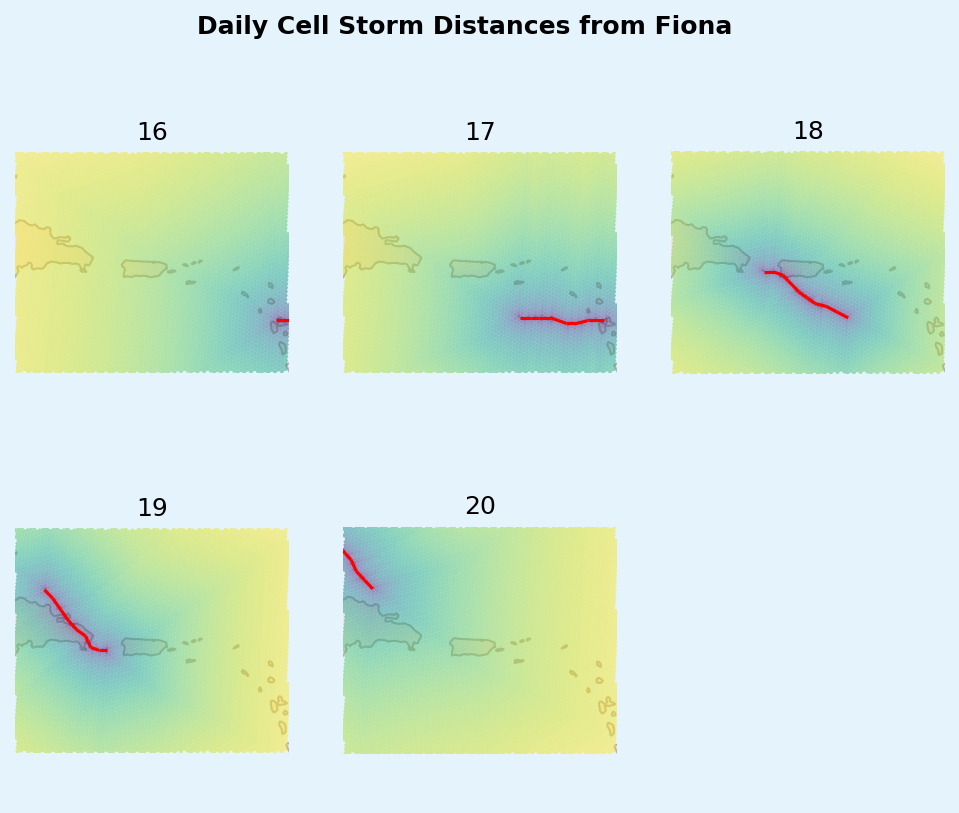

In [21]:
joined_daily_map = daily_map\
    .sort_values(['H3','Day'])\
    .merge(
        nearest_storm_cell.drop(['H3_GEOM','H3_right'],axis=1),
        how='left',
        on=['H3','Day']
    )\
    .merge(
        mhc[['H3']].assign(Marine_Highway=True),
        how='left',
        on='H3'
    )\
    .merge(
        is_land_neighbors,
        how='left',
        on='H3'
    )\
    .merge(
        sls2[['H3','SL','SL_TYPE_Middle']],
        how='left',
        on='H3'
    )\
    .assign(SL=lambda df: df['SL'].fillna(False))\
    .assign(SL_TYPE_Middle = lambda df: df['SL_TYPE_Middle'].fillna(False))\
    .assign(Marine_Highway = lambda df: df['Marine_Highway'].fillna(False))\
    .assign(Storm_Close=lambda df: ~pd.isnull(df['DIST']))\
    .drop(['A'],axis=1)\
    .merge(
        ship_daily_cell_counts,
        how='left',
        on=['H3','Day']
    )\
    .fillna({
        'SHIP_COUNT':0,
        'LOG_SHIP_COUNT':0
         
    })\
    .merge(
        nearest_land_cell.drop(['H3_GEOM'],axis=1).rename(columns={'DIST':'DIST_LAND'}),
        how='left',
        on=['H3','Day']
    )\
    .merge(
        ports_sum[['H3','NUM_DOCKS','NEIGHBOR_DOCKS','Is_Dock','Is_Neighbor_Dock']],
        how='left',
        on='H3'
    )\
    .drop_duplicates(subset=['H3','Day'])\
    .assign(LOG_DIST = lambda df: np.log1p(df['DIST']))\
    .assign(LOG_DIST_LAND = lambda df: np.log1p(df['DIST_LAND']))\


joined_daily_map = joined_daily_map\
    .merge(joined_daily_map.groupby('Day')['Storm_Close'].max().reset_index().rename(columns={'Storm_Close':'Any_Storm'}),
           how='left',
           on=['Day'])

display(joined_daily_map)

sc = joined_daily_map.query("Storm_Close == True")

fig,ax = setup_figure((2,3),fs=(8,6))

dcnt = min(sc['Day'])
for i in range(2):
    for j in range(3):
        ax[i][j] = clean_axis(ax[i][j])

        if dcnt <= max(sc['Day']):
            ax[i][j] = add_countries(ax[i][j])

            ax[i][j].set_title(dcnt)
            sc.query("Day == @dcnt").plot(column='LOG_DIST',ax=ax[i][j],alpha=.5)
            best_track.query("day == @dcnt").plot(ax=ax[i][j],color='Red')

        dcnt += 1

fig.suptitle('Daily Cell Storm Distances from Fiona',fontweight='bold')

    

### Analyze and model how ship counts relate to the storm
Buid a pair plot to analyze any of the relationships between variables

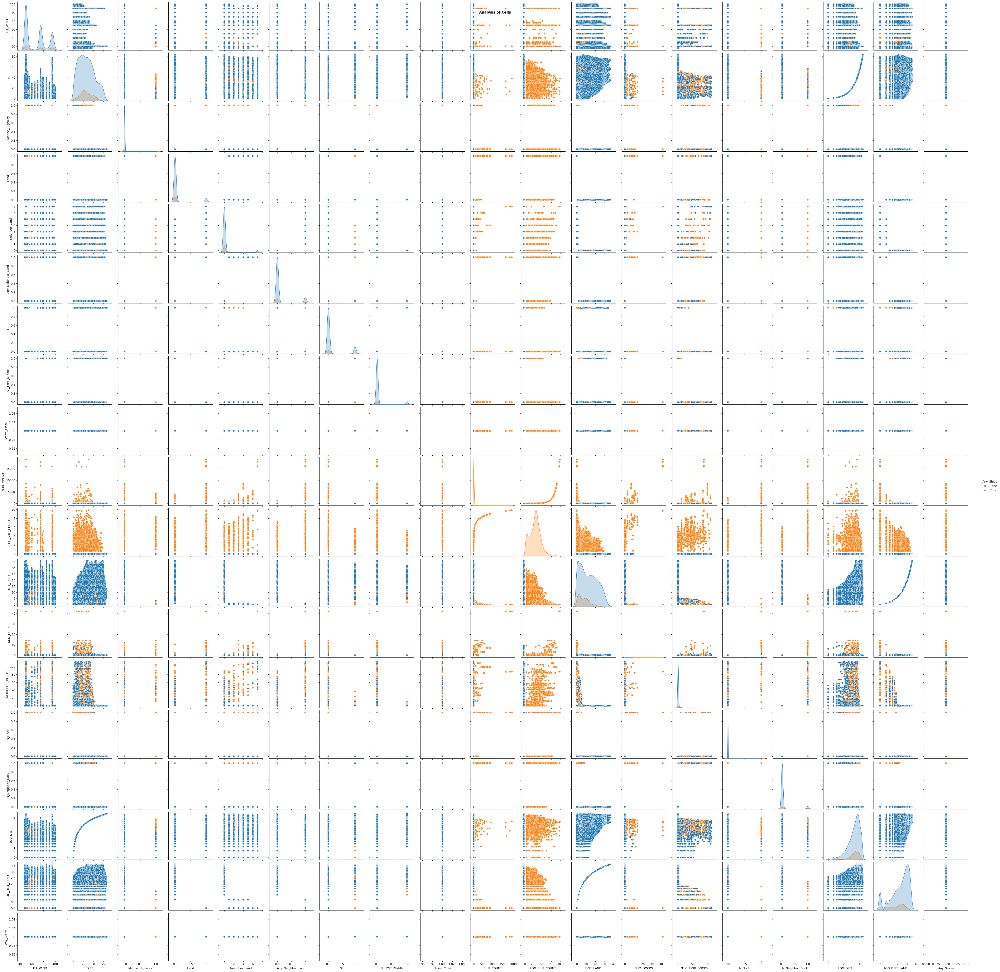

In [22]:
g = sns.pairplot(joined_daily_map.dropna().select_dtypes(['int','float','bool']).drop(['Day'],axis=1).assign(Any_Ships = lambda df: df['SHIP_COUNT']>0),hue='Any_Ships')#,corner=True)
g.fig.suptitle('Analysis of Cells',fontweight='bold')
g.fig.set_facecolor('white')
g.fig.axes[0].set_facecolor('white')

### Build a Model

In [23]:
# Load the datasets
X = joined_daily_map[['LOG_DIST','LOG_DIST_LAND','Land','Marine_Highway','SL','SL_TYPE_Middle','Storm_Close','Neighbor_Land','Any_Neighbor_Land','NUM_DOCKS','NEIGHBOR_DOCKS','Is_Dock','Is_Neighbor_Dock']]
y = joined_daily_map['LOG_SHIP_COUNT']  

#Build an XGBoost regression model
model = xgb.XGBRegressor(
    objective='reg:squarederror',
    eval_metric='rmse',         
    n_estimators=1000,          
    learning_rate=0.1,          
    max_depth=6                 
)

#Set up 5 k fold validation
kf = KFold(n_splits=5, shuffle=True, random_state=2025)  
mse_scores = []  # 

for train_index, test_index in kf.split(X):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    #Fit the model
    model.fit(X_train, y_train)

    #Predict and 0 bound the results
    y_pred = model.predict(X_test)
    y_pred = np.where(y_pred < 0,0, y_pred)

    # OOS Error
    mse = mean_squared_error(y_test, y_pred)
    mse_scores.append(mse)
    
    print(f"MSE: {mse:.4f}")

# Calculate the average performance metrics
avg_mse = sum(mse_scores) / len(mse_scores)

print(f"Average MSE: {avg_mse:.4f}")


MSE: 0.8563
MSE: 0.8625
MSE: 0.8641
MSE: 0.8400
MSE: 0.8789
Average MSE: 0.8603


In [24]:
# Train the model on the full data set and add in the predictions to the geodataframe for plotting
model.fit(X, y)
y_pred = model.predict(X)
y_pred = np.where(y_pred < 0,0, y_pred)

joined_daily_map['LOG_SHIP_PRED'] =  y_pred

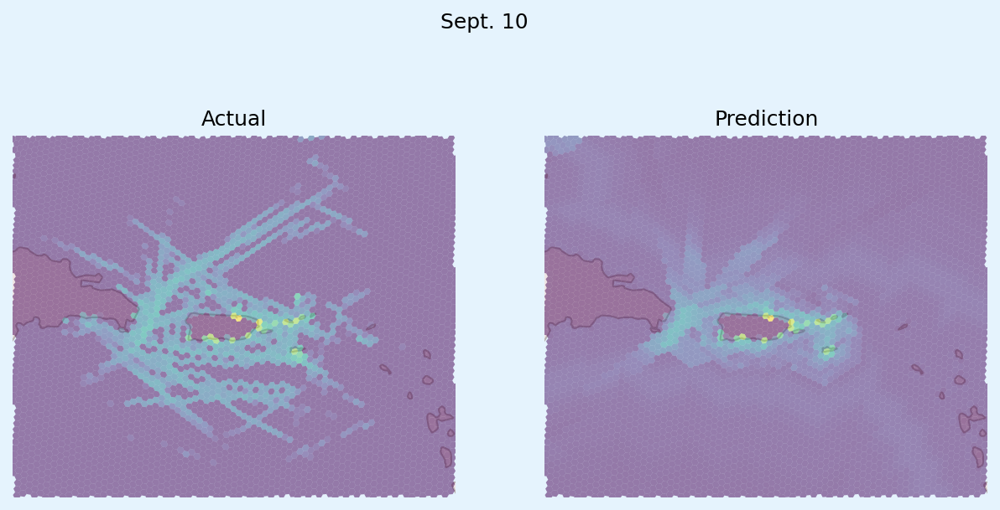

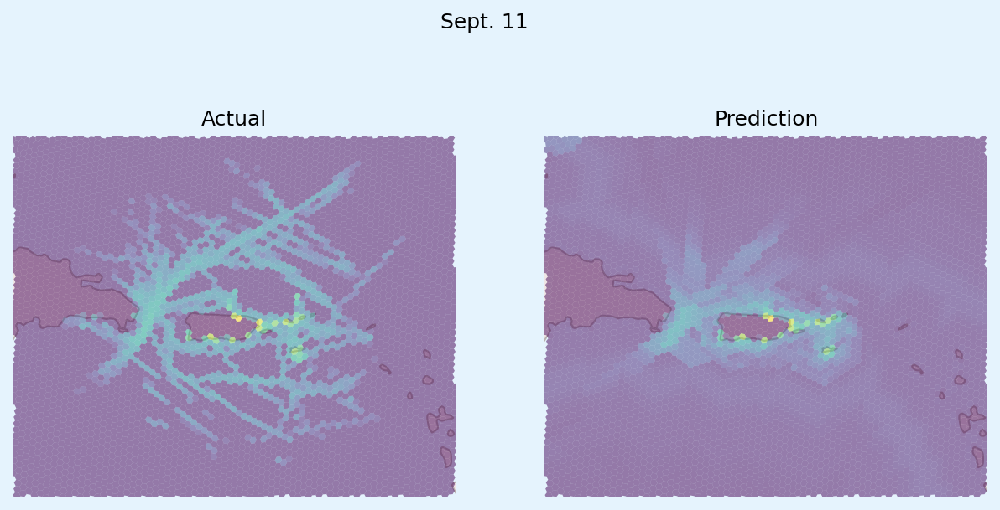

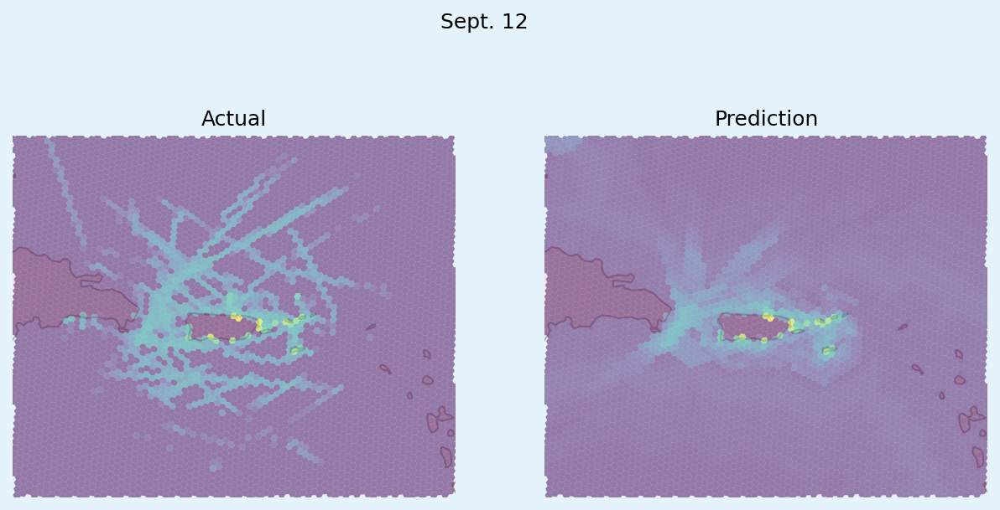

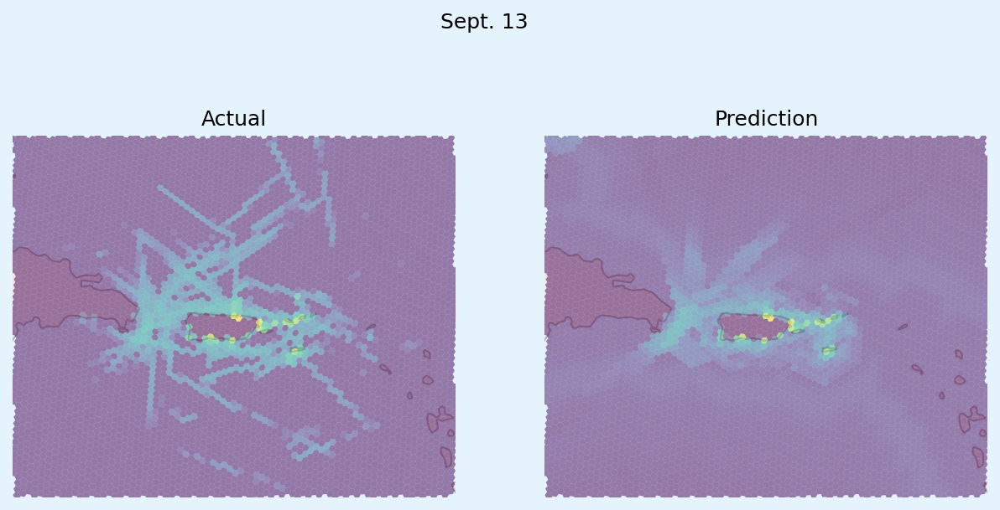

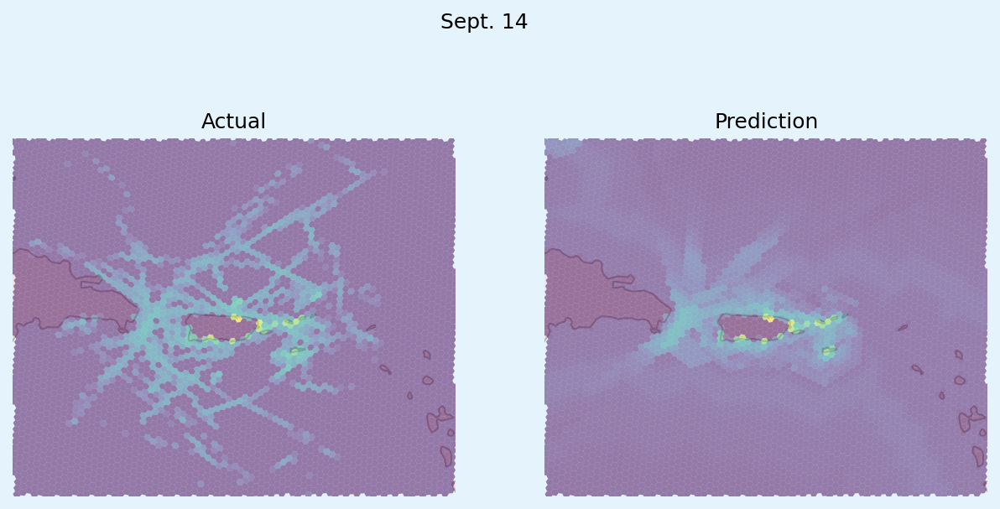

...

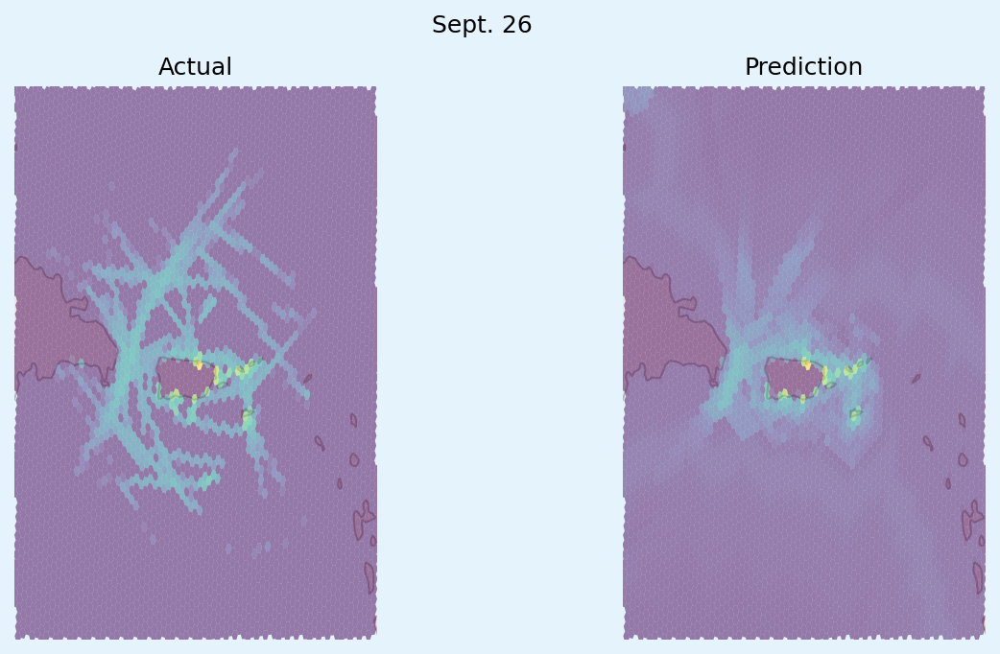

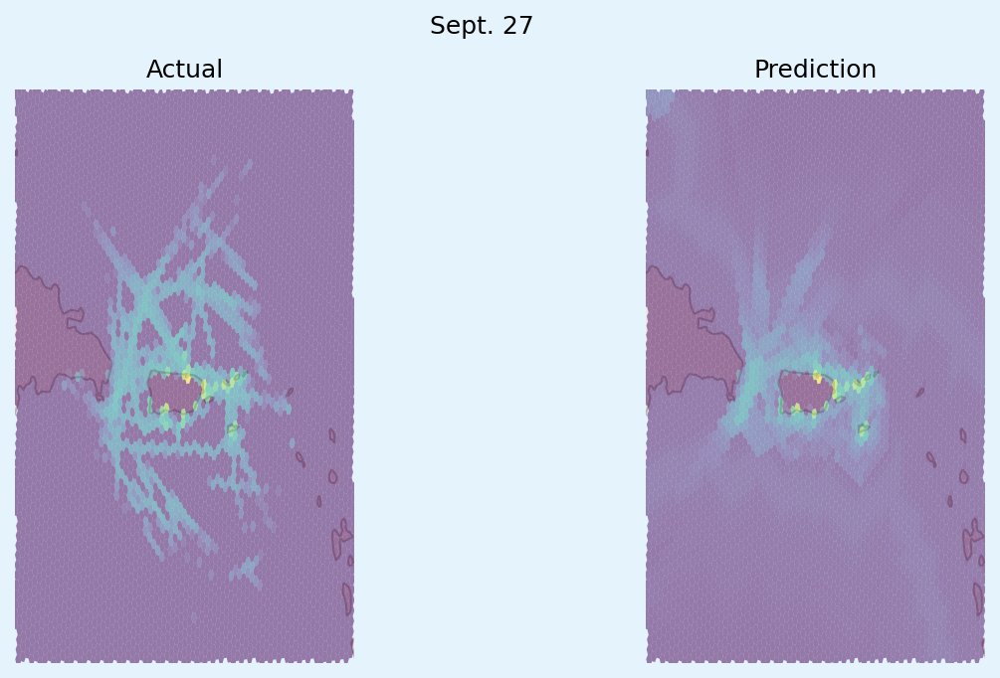

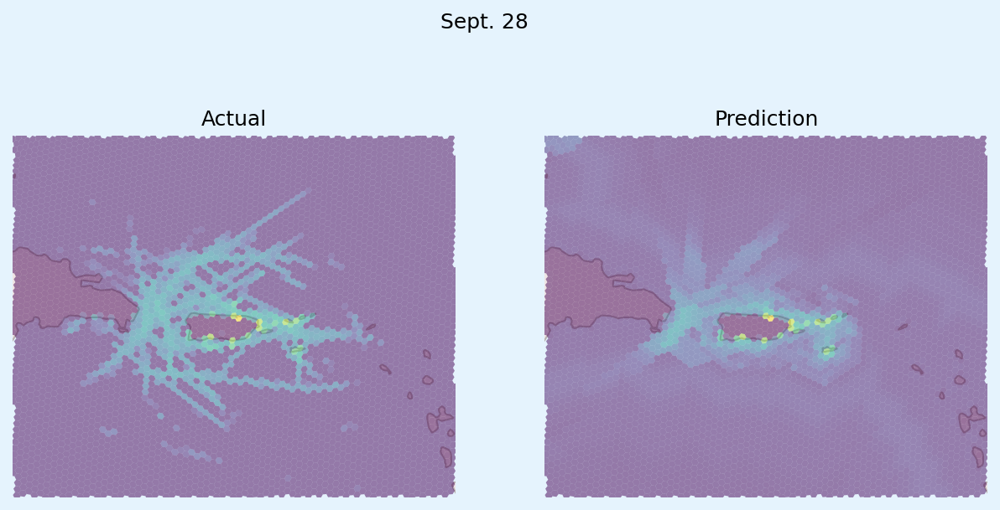

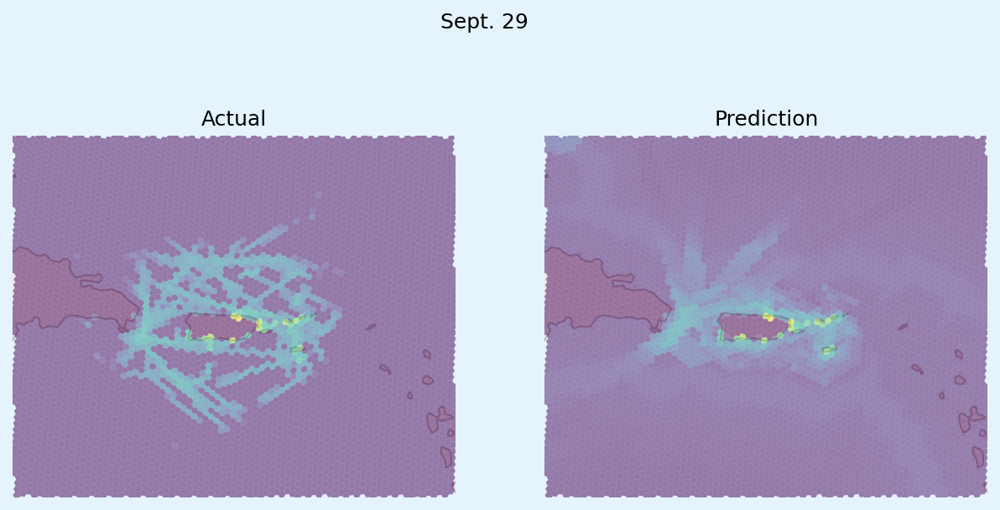

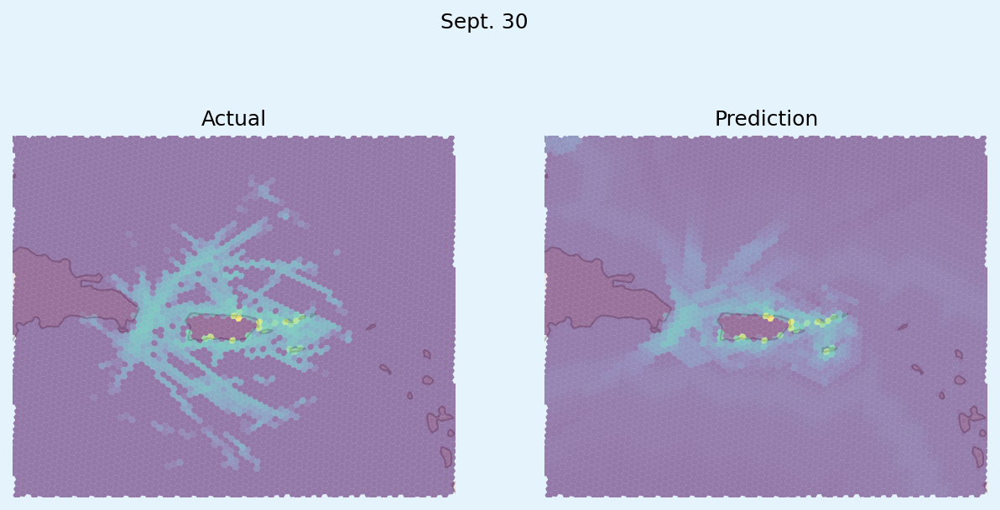

In [ ]:
plt.close('all')
#Plot the actuals vs. predicted for each day
for i, jd in joined_daily_map.groupby('Day'):

    fig, ax = setup_figure((1,2),(10,5))

    ax[0] = add_countries(ax[0])
    ax[1] = add_countries(ax[1])

    jd.plot(column='LOG_SHIP_COUNT',ax=ax[0],alpha=.5)
    jd.plot(column='LOG_SHIP_PRED',ax=ax[1],alpha=.5)

    bt = best_track.query("day == @i")
    if len(bt) > 0:
        bt.plot(ax=ax[0],color='Red')
        bt.plot(ax=ax[1],color='Red')

    ax[0].set_title('Actual')
    ax[1].set_title('Prediction')

    clean_axis(ax[0])
    clean_axis(ax[1])

    fig.suptitle(f'Sept. {str(i)}')

    plt.show()


### Examining Important Features
Through utilizing the SHAP library we can explore the feature importance of how some of these predictions interacted

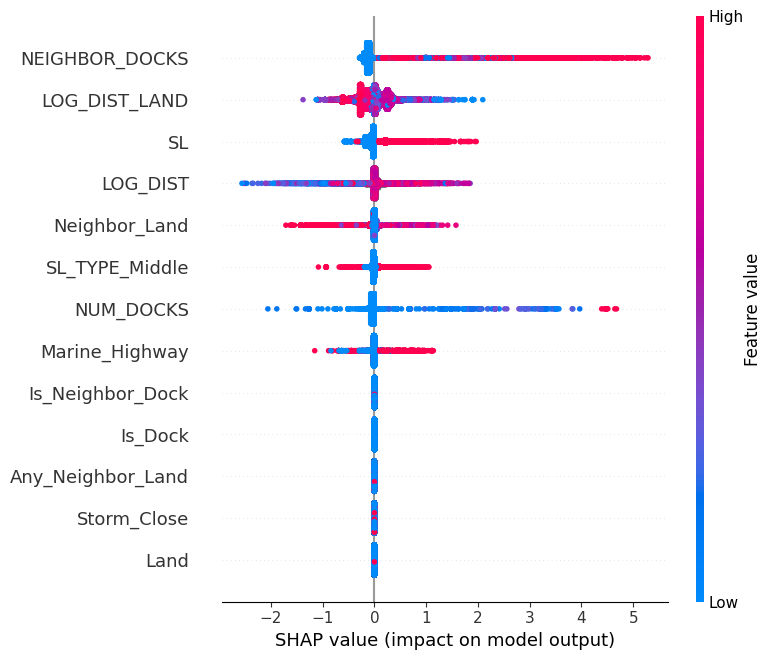

In [29]:
explainer = shap.Explainer(model)
shap_values = explainer(X)
shap.summary_plot(shap_values, X,show=False)

In [32]:
shap_gpd = gpd.GeoDataFrame(pd.DataFrame(shap_values.values,columns=X.columns)\
    .assign(H3=joined_daily_map['H3'])\
    .assign(H3_GEOM =joined_daily_map['H3_GEOM']))\
    .assign(PRED=joined_daily_map['LOG_SHIP_PRED'])\
    .assign(ACT=joined_daily_map['LOG_SHIP_COUNT'])\
    .assign(Day=joined_daily_map['Day'])\
    .assign(IL=list(range(1, len(shap_values.values) + 1)))\
    .set_geometry('H3_GEOM')\
    .set_crs('EPSG:4326')\
    .drop_duplicates(subset=['H3','Day'])

We can now examine individual H3 grid plots to examine the impact of model effects.

Text(0.5, 0.98, 'Sept 10 - H3 854cc0d3fffffff (Shipping Lanes Highlighted)')

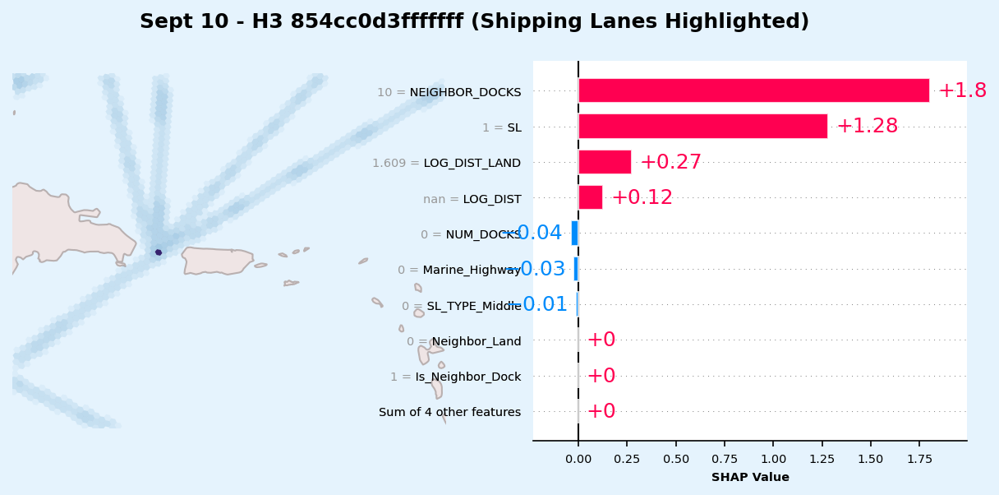

In [36]:
fig, ax = setup_figure((1,2),(10,4))
ax[0] = add_countries(ax[0])
ax[0] = clean_axis(ax[0])

shap_gpd.query("H3 == '854cc0d3fffffff' and Day == 10").plot(ax=ax[0],column='PRED')
shap.plots.bar(shap_values[14827],ax=ax[1],show=False)
sls.plot(ax=ax[0],alpha=.05)
ax[1].tick_params(axis='y', labelsize='x-small') 
ax[1].tick_params(axis='x', labelsize='x-small') 
ax[1].set_xlabel('SHAP Value',fontweight='bold',size='x-small')
fig.suptitle('Sept 10 - H3 854cc0d3fffffff (Shipping Lanes Highlighted)',fontweight='bold')


On this cell during the day the hurricane hit we can see the impact of the log(distance to storm) as well as neighboring docks

Text(0.5, 0.98, 'Sept 18 - H3 854cc0abfffffff - Pole Ojea')

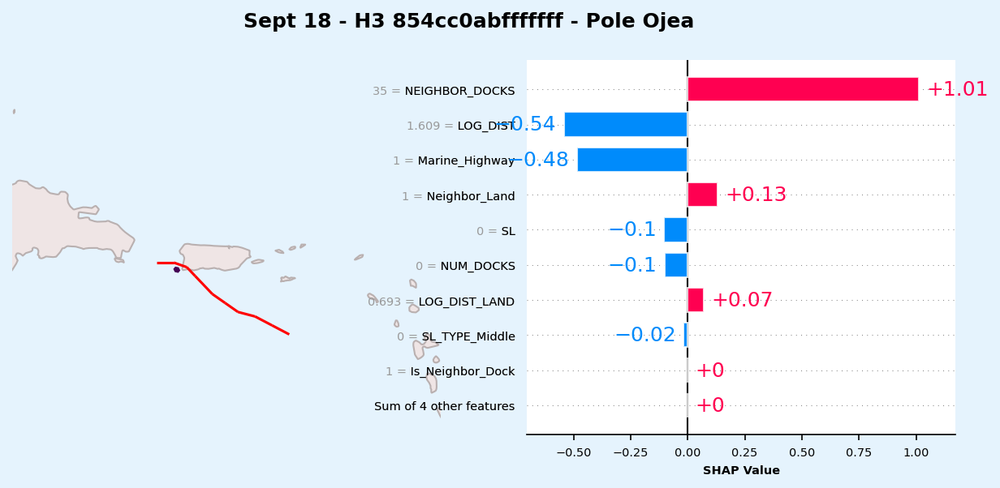

In [37]:
fig, ax = setup_figure((1,2),(10,4))
ax[0] = add_countries(ax[0])
ax[0] = clean_axis(ax[0])
best_track.query("day == 18").plot(ax=ax[0],color='red')
shap_gpd.query("H3 == '854cc0abfffffff' and Day == 18").plot(ax=ax[0],column='PRED')
shap.plots.bar(shap_values[14646],ax=ax[1],show=False)
ax[1].tick_params(axis='y', labelsize='x-small') 
ax[1].tick_params(axis='x', labelsize='x-small') 
ax[1].set_xlabel('SHAP Value',fontweight='bold',size='x-small')
fig.suptitle('Sept 18 - H3 854cc0abfffffff - Pole Ojea',fontweight='bold')


# Summmary
Our machine learning project aimed at predicting how hurricanes would impact ship traffic in Puerto Rico turned out to be interesting. Focusing on the intersection of weather events and maritime operations, we were able to gain  insights into the patterns of ship movements during the storm. One of the key aspects that made the project particularly interesting was the decision to distill our analysis into H3's grids. This allowed us to efficiently represent large geographical areas and track how specific regions were affected by storm impacts at a granular level, making it easier to identify critical patterns and trends.

The use of H3's grids made our predictions not only more precise but also scalable and computationally efficient. By aggregating data into these grids, we were able to visualize changes in ship traffic with much more clarity, tracking movements across different areas of the island as the storms evolved. This allowed us to see which parts of Puerto Rico, particularly the docks and shipping lanes, were most at risk or seeing increased activity as the hurricanes approached and subsequently passed.